# Data

In [34]:
!ls data/model_input/trainA | head

20_0_0_20170104020603909.jpg.chip.jpg
20_0_0_20170104230025073.jpg.chip.jpg
20_0_0_20170104230042553.jpg.chip.jpg
20_0_0_20170104230048181.jpg.chip.jpg
20_0_0_20170104230051977.jpg.chip.jpg
20_0_0_20170104230054071.jpg.chip.jpg
20_0_0_20170105161704786.jpg.chip.jpg
20_0_0_20170105161706251.jpg.chip.jpg
20_0_0_20170105183430767.jpg.chip.jpg
20_0_0_20170105184038831.jpg.chip.jpg
ls: write error: Broken pipe


trainA is for age 20 and trainB is for age 50

In [35]:
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import random


def show_imgs(path, num=5, figsize=(20,10), columns=5):
    images = []
    paths = glob.glob(path+"/*")
    paths = [paths[random.randrange(len(paths))] for item in range(num)]
    for img_path in paths:
        images.append(mpimg.imread(img_path))
    plt.figure(figsize=figsize)
    for i, image in enumerate(images):
        plt.subplot(len(images) / columns + 1, columns, i + 1)
        plt.imshow(image)

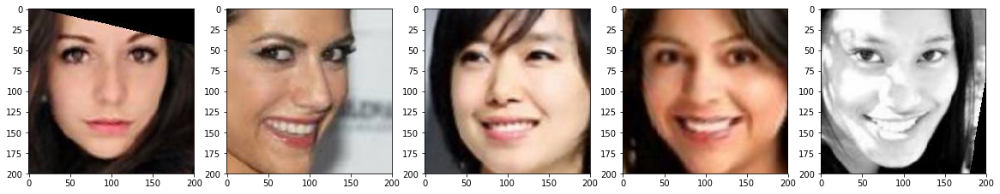

In [36]:
show_imgs('data/model_input/trainA')

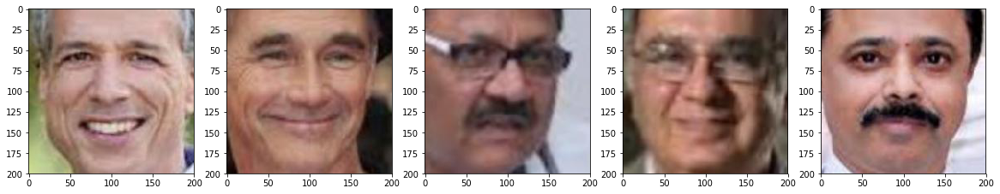

In [37]:
show_imgs('data/model_input/trainB')

# Modules

In [38]:
from __future__ import division
import os
import time
from glob import glob
import tensorflow as tf
import numpy as np
from collections import namedtuple
import tensorflow as tf
import tensorflow.contrib.slim as slim
import math
import numpy as np
import pprint
import scipy.misc
import copy

In [39]:
def lrelu(x, leak=0.2, name="lrelu"):
    return tf.maximum(x, leak*x)

In [40]:
def instance_norm(input, name="instance_norm"):
    with tf.variable_scope(name):
        depth = input.get_shape()[3]           # Number of channels.

        # Average 1, standard deviation 0.02 nomal distribution, ie number of channels.
        scale = tf.get_variable("scale", [depth], initializer=tf.random_normal_initializer(1.0, 0.02, dtype=tf.float32))

        # Create variable for the number of channels.
        offset = tf.get_variable("offset", [depth], initializer=tf.constant_initializer(0.0))

        mean, variance = tf.nn.moments(input, axes=[1,2], keep_dims=True)       # Find the mean and variance for the width and height.
        epsilon = 1e-5
        inv = tf.rsqrt(variance + epsilon)
        normalized = (input-mean)*inv
        return scale*normalized + offset

In [41]:
def conv2d(input_, output_dim, ks=4, s=2, stddev=0.02, padding='SAME', name="conv2d"):
    with tf.variable_scope(name):       # 앞에 conv2d가 붙음.
        # output_dim == Number of filters. ks == kernel size (4 x 4) s == stride, no active function.
        # Image size 0.5 times
        return slim.conv2d(input_, output_dim, ks, s, padding=padding, activation_fn=None,
                            weights_initializer=tf.truncated_normal_initializer(stddev=stddev),
                            biases_initializer=None)

In [42]:
def deconv2d(input_, output_dim, ks=4, s=2, stddev=0.02, name="deconv2d"):
    with tf.variable_scope(name):
       # Image size is doubled in both horizontal and vertical directions.
        return slim.conv2d_transpose(input_, output_dim, ks, s, padding='SAME', activation_fn=None,
                                    weights_initializer=tf.truncated_normal_initializer(stddev=stddev),
                                    biases_initializer=None)

In [43]:
# Pooling images
class ImagePool(object):
    def __init__(self, maxsize=50):
        self.maxsize = maxsize
        self.num_img = 0
        self.images = []

    def __call__(self, image):
        if self.maxsize <= 0:
            return image
        if self.num_img < self.maxsize:
            self.images.append(image)
            self.num_img += 1
            return image
        if np.random.rand() > 0.5:
            idx = int(np.random.rand()*self.maxsize)
            tmp1 = copy.copy(self.images[idx])[0]
            self.images[idx][0] = image[0]
            idx = int(np.random.rand()*self.maxsize)
            tmp2 = copy.copy(self.images[idx])[1]
            self.images[idx][1] = image[1]
            return [tmp1, tmp2]
        else:
            return image

In [44]:
def sce_criterion(logits, labels):
    return tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=logits, labels=labels))

In [45]:
def mae_criterion(in_, target):
    return tf.reduce_mean((in_-target)**2)

In [46]:
def abs_criterion(in_, target):
    return tf.reduce_mean(tf.abs(in_ - target))

In [47]:
def discriminator(image, options, reuse=False, name="discriminator"):

    with tf.variable_scope(name):
        # image is 256 x 256 x input_c_dim
        if reuse:
            tf.get_variable_scope().reuse_variables()
        else:
            assert tf.get_variable_scope().reuse is False

        h0 = lrelu(conv2d(image, options.df_dim, name='d_h0_conv'))
        # h0 is (128 x 128 x self.df_dim)
        h1 = lrelu(instance_norm(conv2d(h0, options.df_dim*2, name='d_h1_conv'), 'd_bn1'))
        # h1 is (64 x 64 x self.df_dim*2)
        h2 = lrelu(instance_norm(conv2d(h1, options.df_dim*4, name='d_h2_conv'), 'd_bn2'))
        # h2 is (32x 32 x self.df_dim*4)
        h3 = lrelu(instance_norm(conv2d(h2, options.df_dim*8, s=1, name='d_h3_conv'), 'd_bn3'))
        # h3 is (32 x 32 x self.df_dim*8)
        h4 = conv2d(h3, 1, s=1, name='d_h3_pred')
        # h4 is (32 x 32 x 1)
        return h4

In [48]:
def generator_resnet(image, options, reuse=False, name="generator"):

    with tf.variable_scope(name):
        # image is 256 x 256 x input_c_dim
        if reuse:
            tf.get_variable_scope().reuse_variables()
        else:
            assert tf.get_variable_scope().reuse is False

        def residule_block(x, dim, ks=3, s=1, name='res'):
            p = int((ks - 1) / 2)
            y = tf.pad(x, [[0, 0], [p, p], [p, p], [0, 0]], "REFLECT")      # padding is only one side up or down. p is the padding value.

            # instance_norm은 nomalization.
            y = instance_norm(conv2d(y, dim, ks, s, padding='VALID', name=name+'_c1'), name+'_bn1')
            y = tf.pad(tf.nn.relu(y), [[0, 0], [p, p], [p, p], [0, 0]], "REFLECT")
            y = instance_norm(conv2d(y, dim, ks, s, padding='VALID', name=name+'_c2'), name+'_bn2')
            return y + x            # Shouldn't you be # 1/2 ??? Doesn't matter if you normalize afterwards ...

        # Justin Johnson's model from https://github.com/jcjohnson/fast-neural-style/
        # The network with 9 blocks consists of: c7s1-32, d64, d128, R128, R128, R128,
        # R128, R128, R128, R128, R128, R128, u64, u32, c7s1-3
        c0 = tf.pad(image, [[0, 0], [3, 3], [3, 3], [0, 0]], "REFLECT")     # 3 padding up and down horizontally and vertically.
        c1 = tf.nn.relu(instance_norm(conv2d(c0, options.gf_dim, 7, 1, padding='VALID', name='g_e1_c'), 'g_e1_bn'))    # Padding is already valid.
        c2 = tf.nn.relu(instance_norm(conv2d(c1, options.gf_dim*2, 3, 2, name='g_e2_c'), 'g_e2_bn'))
        c3 = tf.nn.relu(instance_norm(conv2d(c2, options.gf_dim*4, 3, 2, name='g_e3_c'), 'g_e3_bn'))        # 64 *64

        # define G network with 9 resnet blocks
        # 18 floors total cnn.
        r1 = residule_block(c3, options.gf_dim*4, name='g_r1')
        r2 = residule_block(r1, options.gf_dim*4, name='g_r2')
        r3 = residule_block(r2, options.gf_dim*4, name='g_r3')
        r4 = residule_block(r3, options.gf_dim*4, name='g_r4')
        r5 = residule_block(r4, options.gf_dim*4, name='g_r5')
        r6 = residule_block(r5, options.gf_dim*4, name='g_r6')
        r7 = residule_block(r6, options.gf_dim*4, name='g_r7')
        r8 = residule_block(r7, options.gf_dim*4, name='g_r8')
        r9 = residule_block(r8, options.gf_dim*4, name='g_r9')

        d1 = deconv2d(r9, options.gf_dim*2, 3, 2, name='g_d1_dc')
        d1 = tf.nn.relu(instance_norm(d1, 'g_d1_bn'))
        d2 = deconv2d(d1, options.gf_dim, 3, 2, name='g_d2_dc')
        d2 = tf.nn.relu(instance_norm(d2, 'g_d2_bn'))
        d2 = tf.pad(d2, [[0, 0], [3, 3], [3, 3], [0, 0]], "REFLECT")

        # I have padded above and use 7 by 7 filter.
        pred = tf.nn.tanh(conv2d(d2, options.output_c_dim, 7, 1, padding='VALID', name='g_pred_c'))



        return pred

# Utils

In [49]:
import cv2
import scipy.misc

def imreadf(path, is_grayscale = False):
    if (is_grayscale):
        return cv2.imread(path).astype(np.float)
    else:
        return cv2.imread(path).astype(np.float)

def load_test_data(image_path, fine_size=256):
    img = imreadf(image_path)
    img = cv2.resize(img, (fine_size, fine_size))
    img = img/127.5 - 1         # -1에서 1사이로 맞추려고.
    return img

def load_train_data(image_path, load_size=286, fine_size=256, is_testing=False):
    img_A = imreadf(image_path[0])
    img_B = imreadf(image_path[1])

    if not is_testing:  # 훈련 중
        img_A = cv2.resize(img_A, (load_size, load_size))
        img_B = cv2.resize(img_B, (load_size, load_size))
        h1 = int(np.ceil(np.random.uniform(1e-2, load_size-fine_size))) # 1에서 load_size-fine_size 사이의 값 하나.
        w1 = int(np.ceil(np.random.uniform(1e-2, load_size-fine_size)))
        img_A = img_A[h1:h1+fine_size, w1:w1+fine_size]         # 이미지를 랜덤하게 컷팅... why??
        img_B = img_B[h1:h1+fine_size, w1:w1+fine_size]

        if np.random.random() > 0.5:                # 50프로 확률로 이미지 뒤집기
            img_A = np.fliplr(img_A)
            img_B = np.fliplr(img_B)

    else:   # 테스트 중!
        img_A = cv2.resize(img_A, (fine_size, fine_size))
        img_B = cv2.resize(img_B, (fine_size, fine_size))

    img_A = img_A/127.5 - 1.
    img_B = img_B/127.5 - 1.

    img_AB = np.concatenate((img_A, img_B), axis=2)
    # img_AB shape: (fine_size, fine_size, input_c_dim + output_c_dim)
    return img_AB

def get_image(image_path, image_size, is_crop=True, resize_w=64, is_grayscale = False):
    return transform(imreadf(image_path, is_grayscale), image_size, is_crop, resize_w)

def save_images(images, size, image_path):
    return imsave(inverse_transform(images), size, image_path)

def merge_images(images, size):
    return inverse_transform(images)

def merge(images, size):
    h, w = images.shape[1], images.shape[2]
    img = np.zeros((h * size[0], w * size[1], 3))
    for idx, image in enumerate(images):
        i = idx % size[1]
        j = idx // size[1]
        img[j*h:j*h+h, i*w:i*w+w, :] = image

    return img

def imsave(images, size, path):
    print('saving result to ', path)
    img=merge(images, size)
    print("log ", img.shape)
    fig = plt.imshow(img)
    plt.axis('off')
    fig.axes.get_xaxis().set_visible(False)
    fig.axes.get_yaxis().set_visible(False)
    plt.savefig(path, bbox_inches='tight', transparent=True,pad_inches=0)
    return "Done"


def center_crop(x, crop_h, crop_w,
                resize_h=64, resize_w=64):
    if crop_w is None:
        crop_w = crop_h
    h, w = x.shape[:2]
    j = int(round((h - crop_h)/2.))
    i = int(round((w - crop_w)/2.))
    return cv2.resize(x[j:j+crop_h, i:i+crop_w], (resize_h, resize_w))

def transform(image, npx=64, is_crop=True, resize_w=64):
    # npx : # of pixels width/height of image
    if is_crop:
        cropped_image = center_crop(image, npx, resize_w=resize_w)
    else:
        cropped_image = image
    return np.array(cropped_image)/127.5 - 1.

def inverse_transform(images):
    return (images+1.)/2.

In [50]:
import cv2
i=cv2.imread('data/model_input/trainA/20_0_0_20170104230025073.jpg.chip.jpg').astype(np.float)
i.shape

(200, 200, 3)

In [51]:
v=cv2.resize(i,(256,256))

In [52]:
from matplotlib import pyplot as plt
import numpy as np
import cv2

def disp(path):
    from IPython.display import Image
    display(Image(filename=path) )

In [53]:
from PIL import Image
def disp_gen(path):
    data=cv2.imread(path)
    img=Image.fromarray(data)
    display(img)

# Model

In [54]:
class cyclegan():
    def __init__(self, sess, checkpoint_dir, test_dir, dataset_dir, which_direction, batch_size,fine_size):
        self.sess = sess
        self.batch_size = batch_size
        self.image_size = fine_size       
        self.input_c_dim = 3        
        self.output_c_dim = 3       
        self.L1_lambda = 10.0
        self.fine_size = fine_size
        self.ngf = 64         # G first conv layer filter number
        self.ndf = 64         # D first conv layer filter count
        self.output_nc = 3
        self.max_size = 50
        self.beta1 = 0.5        # adam second option
        self.epoch = 1       
        self.epoch_step = 100   # Steps to reduce # lr
        self.train_size = 1e8   # Number of images at training ??
        self.lr_init = 0.0002        # The first lr
        self.load_size = 286
        self.save_freq = 500    # Storage frequency
        self.continue_train = True         # Always train continuously.

        # Path collection
        self.checkpoint_dir = checkpoint_dir        
        self.dataset_dir = dataset_dir              
        self.test_dir = test_dir                    # The path to save the test image.

        # G and D
        self.discriminator = discriminator
        self.generator = generator_resnet  # generator using resnet

        # loss_fn
        self.original_GAN_loss = mae_criterion

        self.which_direction = which_direction

        OPTIONS = namedtuple('OPTIONS', 'batch_size image_size \
                                      gf_dim df_dim output_c_dim')
        self.options = OPTIONS._make((self.batch_size, self.fine_size,
                                      self.ngf, self.ndf, self.output_nc,))       #ngf is the number of the first conv layer filter of the generator function
                                      #self.phase == 'train'))

        self._build_model()         # Create model
        #writer = tf.train.SummaryWriter("/tmp/test_logs", sess.graph)
        self.saver = tf.train.Saver()
        self.pool = ImagePool(self.max_size)

    def _build_model(self):
        self.real_data = tf.placeholder(tf.float32,
                                        [None, self.image_size, self.image_size,
                                         self.input_c_dim + self.output_c_dim],    # input image channel and output image channel number # probably both 3. RGB.
                                        name='real_A_and_B_images')

        self.real_A = self.real_data[:, :, :, :self.input_c_dim]            # The first part of self.real_data, ie, real A
        self.real_B = self.real_data[:, :, :, self.input_c_dim:self.input_c_dim + self.output_c_dim] # real B
        self.fake_B = self.generator(self.real_A, self.options, False, name="generatorA2B")     # Replace A with a fake B.
        self.fake_A_ = self.generator(self.fake_B, self.options, False, name="generatorB2A")    # Replace fake B with fake A
        # Use predefined reuse.
        self.fake_A = self.generator(self.real_B, self.options, True, name="generatorB2A")      # Replace real B with fake A
        self.fake_B_ = self.generator(self.fake_A, self.options, True, name="generatorA2B")     # Replace fake A with fake B
        self.DB_fake = self.discriminator(self.fake_B, self.options, reuse=False, name="discriminatorB")       # 32 BY 32 comes out ..
        self.DA_fake = self.discriminator(self.fake_A, self.options, reuse=False, name="discriminatorA")

        "" "The final loss necessary to learn G & F"
        self.g_loss = self.original_GAN_loss(self.DA_fake, tf.ones_like(self.DA_fake)) \
            + self.original_GAN_loss(self.DB_fake, tf.ones_like(self.DB_fake)) \
            + self.L1_lambda * abs_criterion(self.real_A, self.fake_A_) \
            + self.L1_lambda * abs_criterion(self.real_B, self.fake_B_)

#         "" "New additional loss
        #########################################################
#         self.A_and_GA_hyunbo = self.generator(self.real_A, self.options, True, name="generatorB2A")
#         self.B_and_GB_hyunbo = self.generator(self.real_B, self.options, True, name="generatorA2B")
#         self.g_loss_by_hyunbo = self.L1_lambda * abs_criterion(self.real_A, self.A_and_GA_hyunbo) \
#                                     + self.L1_lambda * abs_criterion(self.real_B, self.B_and_GB_hyunbo)

        #########################################################"""
#         "" "=============================== Here's a lesson from D ========= ================= "" "
        # Capital letter D seems to function like a function.
        self.fake_A_sample = tf.placeholder(tf.float32,
                                            [None, self.image_size, self.image_size,
                                             self.input_c_dim], name='fake_A_sample')
        self.fake_B_sample = tf.placeholder(tf.float32,
                                            [None, self.image_size, self.image_size,
                                             self.output_c_dim], name='fake_B_sample')

        # Put real B to get 32 by 32.
        self.DB_real = self.discriminator(self.real_B, self.options, reuse=True, name="discriminatorB")
        # Put real A to get 32 by 32.
        self.DA_real = self.discriminator(self.real_A, self.options, reuse=True, name="discriminatorA")
        ## Put a pseudo B to get 32 ​​by 32.
        self.DB_fake_sample = self.discriminator(self.fake_B_sample, self.options, reuse=True, name="discriminatorB")
        # Put a fake A to get 32 ​​by 32.
        self.DA_fake_sample = self.discriminator(self.fake_A_sample, self.options, reuse=True, name="discriminatorA")

        """ D_loss to distinguish real B from fake B """
        self.db_loss_real = self.original_GAN_loss(self.DB_real, tf.ones_like(self.DB_real))
        self.db_loss_fake = self.original_GAN_loss(self.DB_fake_sample, tf.zeros_like(self.DB_fake_sample))
        self.db_loss = (self.db_loss_real + self.db_loss_fake) / 2

        "" "D_loss distinguishes between real A and fake A" ""
        self.da_loss_real = self.original_GAN_loss(self.DA_real, tf.ones_like(self.DA_real))
        self.da_loss_fake = self.original_GAN_loss(self.DA_fake_sample, tf.zeros_like(self.DA_fake_sample))
        self.da_loss = (self.da_loss_real + self.da_loss_fake) / 2

        "" " Final loss for learning D "" "
        self.d_loss = self.da_loss + self.db_loss

        """============================================================================================"""

        """ Made for testing """
        self.test_A = tf.placeholder(tf.float32,
                                     [None, self.image_size, self.image_size,
                                      self.input_c_dim], name='test_A')
        self.test_B = tf.placeholder(tf.float32,
                                     [None, self.image_size, self.image_size,
                                      self.output_c_dim], name='test_B')
        self.testB = self.generator(self.test_A, self.options, True, name="generatorA2B")
        self.testA = self.generator(self.test_B, self.options, True, name="generatorB2A")


        """ We divide the variables when learning D and the variables when learning G. """
        t_vars = tf.trainable_variables()
        self.d_vars = [var for var in t_vars if 'discriminator' in var.name]
        self.g_vars = [var for var in t_vars if 'generator' in var.name]
#         for var in t_vars: print(var.name)

    def train(self):
        """Train cyclegan"""
        self.lr_var = tf.placeholder(tf.float32, None, name='learning_rate')
        self.d_optim = tf.train.AdamOptimizer(self.lr_var, beta1=self.beta1) \
            .minimize(self.d_loss, var_list=self.d_vars)
        self.g_optim = tf.train.AdamOptimizer(self.lr_var, beta1=self.beta1) \
            .minimize(self.g_loss, var_list=self.g_vars)

        """
        #########################################################
        self.hyunbo_optim = tf.train.AdamOptimizer(self.lr_var, beta1=self.beta1) \
            .minimize(self.g_loss_by_hyunbo, var_list=self.g_vars)
        #########################################################
        """

        init_op = tf.global_variables_initializer()    # Initialize all variables.
        self.sess.run(init_op)

        counter = 1
        start_time = time.time()

        if self.continue_train:
            suc_or_fal, num_of_train = self.load()         
            if suc_or_fal:
                print(" check point Import succeeded")
                counter = int(num_of_train.split('-')[1])                    # To save the next one ..
            else:
                print(" Failed to fetch check point")

        for epoch in range(self.epoch):
            dataA = glob('{}/*.*'.format(self.dataset_dir + '/trainA'))
            dataB = glob('{}/*.*'.format(self.dataset_dir + '/trainB'))
#             print("num of dataA : ", dataA.__len__())
#             print("num of dataB : ", dataB.__len__())
            np.random.shuffle(dataA)
            np.random.shuffle(dataB)
            batch_idxs = min(min(len(dataA), len(dataB)), self.train_size) // self.batch_size
            print("epoch starting for bs", self.batch_size)
            print("Number of mini batches :: ", batch_idxs)
            start_time = time.time()
            lr = self.lr_init if epoch < self.epoch_step else self.lr_init*(self.epoch-epoch)/(self.epoch-self.epoch_step)    # lr이 작아짐. 100에폭이 지나면.

            for idx in range(0, batch_idxs):
                batch_files = list(zip(dataA[idx * self.batch_size:(idx + 1) * self.batch_size],
                                       dataB[idx * self.batch_size:(idx + 1) * self.batch_size]))
                # Change image size.
                batch_images = [load_train_data(batch_file, self.load_size, self.fine_size) for batch_file in batch_files] 
                batch_images = np.array(batch_images).astype(np.float32)
#                 print("batch_images", batch_images.shape)
                print(".", end="")
    
                # Update G network and record fake outputs
                fake_A, fake_B, _ = self.sess.run(
                    [self.fake_A, self.fake_B, self.g_optim],
                    feed_dict={self.real_data: batch_images, self.lr_var: lr})

                #self.writer.add_summary(summary_str, counter)
                #[fake_A, fake_B] = self.pool([fake_A, fake_B])

                # Update D network
                self.sess.run( [self.d_optim],
                               feed_dict={self.real_data: batch_images,
                                    self.fake_A_sample: fake_A,
                                    self.fake_B_sample: fake_B,
                                    self.lr_var: lr})
                #self.writer.add_summary(summary_str, counter)

                counter += 1

                # Save.
                if np.mod(counter, self.save_freq) == 2:
                    self.save(counter)
                    print("\n ckpt saved ", counter)
            print(("\n Epoch: [%2d] [%4d/%4d] time: %4.4f" % (epoch, idx, batch_idxs, time.time() - start_time)))

    def save(self, step):

        step_str = str(step)

        self.saver.save(self.sess,
                        self.checkpoint_dir + "/" + step_str,
                        global_step=step)

        """ 여기는 ckpt 파일을 gdrive에 올리는 코드입니다."""
        """latest = tf.train.latest_checkpoint(checkpoint_dir)
        file_name = latest.split("/")
        file_name = file_name[-1]

        list = ['.data-00000-of-00001', '.index', '.meta']
        for x in list:

            drive_service = build('drive', 'v3')
            file_metadata = {
                'name': file_name + x,  # 구글에 올라가는 이름
                'mimeType': None
            }

            media = MediaFileUpload('' + latest + x,
                                    mimetype=None,
                                    resumable=True)
            created = drive_service.files().create(body=file_metadata,
                                                   media_body=media,
                                                   fields='id').execute()
            print('File ID: {}'.format(created.get('id')))
            print(x + "gdrive에 올리기 성공")"""

    def load(self):
        print(" [*] Reading checkpoint...")

        #model_dir = "%s_%s" % (self.dataset_dir, self.image_size)
        #checkpoint_dir = os.path.join(checkpoint_dir, model_dir)

        ckpt = tf.train.get_checkpoint_state(self.checkpoint_dir)
        if ckpt and ckpt.model_checkpoint_path:
            ckpt_name = os.path.basename(ckpt.model_checkpoint_path)
            self.saver.restore(self.sess, os.path.join(self.checkpoint_dir, ckpt_name))
            print(" Checkpoint name !! :", ckpt_name)
            index = ckpt_name.find("-")
            num_of_train = ckpt_name[index + 1:]
            print(" Number of invoked ckpt:", num_of_train)
            time.sleep(10)
            return True, ckpt_name
        else:
            print("check point Is not in the path.")
            return False, 1             # 리턴값 맞춰주기 위해 씀. 아무값이나 리턴

    def test(self):
        """Test cyclegan"""
        init_op = tf.global_variables_initializer()
        self.sess.run(init_op)
        if self.which_direction == 'AtoB':
            sample_files = glob('{}/*.*'.format(self.dataset_dir + '/testA'))
            print("dataset Import succeeded.")
        elif self.which_direction == 'BtoA':
            sample_files = glob('{}/*.*'.format(self.dataset_dir + '/testB'))
            print("dataset Import succeeded.")
        else:
            raise Exception('AtoB BtoA Please choose one of them.')

        if self.load():
            print(" check point Import succeeded")
        else:
            print(" check point Import failed")

        if self.which_direction == 'AtoB':
            out_var, in_var = (self.testB, self.test_A)
        else:
            out_var, in_var = (self.testA, self.test_B)

        print (len(sample_files))
        for sample_file in sample_files:
            print('Processing image: ' + sample_file)
            sample_image = [load_test_data(sample_file, self.fine_size)]
            sample_image = np.array(sample_image).astype(np.float32)
            image_path = os.path.join(self.test_dir,
                                      '{0}_{1}'.format(self.which_direction, os.path.basename(sample_file)))
            fake_img = self.sess.run(out_var, feed_dict={in_var: sample_image})
            print("start saving")
            save_images(fake_img, [1, 1], image_path)
            
    def test_for_files(self, file_paths):
        """Test cyclegan"""
        init_op = tf.global_variables_initializer()
        self.sess.run(init_op)

        if self.load():
            print(" check point Import succeeded")
        else:
            print(" check point Import failed")

        if self.which_direction == 'AtoB':
            out_var, in_var = (self.testB, self.test_A)
        else:
            out_var, in_var = (self.testA, self.test_B)

        print ("Total inputs ", len(file_paths))
        result=[]
        for sample_file in file_paths:
            print('Processing image: ' + sample_file)
            sample_image = [load_test_data(sample_file, self.fine_size)]
            sample_image = np.array(sample_image).astype(np.float32)
            image_path = os.path.join(self.test_dir,
                                      '{0}_{1}'.format(self.which_direction, os.path.basename(sample_file)))
            fake_img = self.sess.run(out_var, feed_dict={in_var: sample_image})
            result.append(image_path)
            save_images(fake_img, [1, 1], image_path)
        return result


# Results

## Tools

In [55]:
from __future__ import division
import os
import time
import tensorflow as tf
import numpy as np
from collections import namedtuple
import tensorflow as tf
import tensorflow.contrib.slim as slim
import math
import numpy as np
import pprint
import scipy.misc
import copy
import cv2

In [56]:
def test(checkpoint_dir,input_files,which_direction): 
    print('test1')
    test='./test_2'
    def createDir(direc):
        if not os.path.exists(direc):
            os.makedirs(direc)
    createDir(test)
    
    tfconfig = tf.ConfigProto(allow_soft_placement=True, log_device_placement=True)        # Using GPU
    tfconfig.gpu_options.allow_growth = True
    
    tf.reset_default_graph() #Reset the old tf graphs on gpu
    
    with tf.Session(config=tfconfig) as sess:
        model = cyclegan(sess, checkpoint_dir = checkpoint_dir, test_dir = test,\
                         dataset_dir= 'dataset_dir', which_direction= which_direction, batch_size=1,fine_size=256)
        return model.test_for_files(input_files)

In [147]:
import glob
import random

def get_samples(num, base_path):
    print(base_path)
    paths = glob.glob(base_path+"/*")
    paths = [paths[random.randrange(len(paths))] for item in range(num)]
    return paths

In [148]:
s = get_samples(7, 'data/model_input/trainA')
s

data/model_input/trainA


['data/model_input/trainA/26_0_0_20170113210127258.jpg.chip.jpg',
 'data/model_input/trainA/22_0_0_20170110232146790.jpg.chip.jpg',
 'data/model_input/trainA/26_1_3_20170119193046825.jpg.chip.jpg',
 'data/model_input/trainA/24_1_1_20170113011154152.jpg.chip.jpg',
 'data/model_input/trainA/26_1_4_20170117154442702.jpg.chip.jpg',
 'data/model_input/trainA/21_0_0_20170104230103695.jpg.chip.jpg',
 'data/model_input/trainA/25_1_4_20170103223722679.jpg.chip.jpg']

In [149]:
def convert_to_rgb(paths):
    for path in paths:
        img = cv2.imread(path)
        bgr_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        cv2.imwrite(path,bgr_img)

In [150]:
from PIL import Image

def plot_imgs(inputs, outputs , col, nrow):
    fs = []
    fs.append(Image.open('data/input_text.png','r'))
    for i in inputs:
        im = Image.open(i,'r')
        fs.append(im)
    fs.append(Image.open('data/output_text.png','r'))
    for i in outputs:
        im = Image.open(i,'r')
        fs.append(im)
    # get the image size
    x,y = fs[0].size
    cvs = Image.new('RGB',(x*col,y*nrow))
    for i in range(len(fs)):
        px, py = x*(i%col), y*int(i/col)
        cvs.paste(fs[i],(px,py))
    return cvs

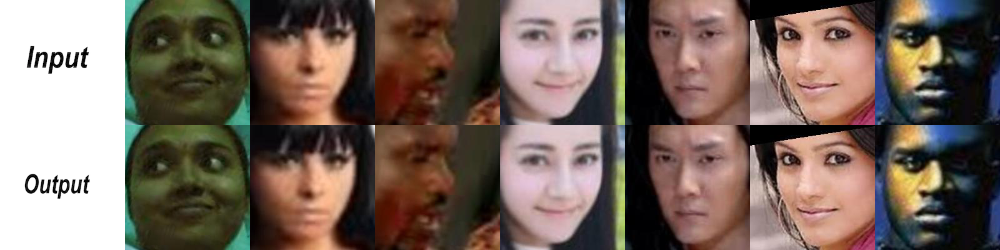

In [87]:
res = plot_imgs(s, s, 8, 2)
res

In [151]:
def get_final_result(checkpoint_dir, num_samples, direction, test_dir, samples=None):
    if samples is None:
        samples = get_samples(num_samples, test_dir)
    res = test(checkpoint_dir,input_files=samples,which_direction=direction)
    convert_to_rgb(res)
    return plot_imgs(samples,res ,num_samples+1, 2)

## age

data/model_input/trainA
test1
 [*] Reading checkpoint...
 Checkpoint name !! : 107502-107502
 Number of invoked ckpt: 107502
 check point Import succeeded
Total inputs  7
Processing image: data/model_input/trainA/24_1_0_20170116215632635.jpg.chip.jpg
saving result to  ./test_2/AtoB_24_1_0_20170116215632635.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainA/24_1_1_20170113011408288.jpg.chip.jpg
saving result to  ./test_2/AtoB_24_1_1_20170113011408288.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainA/26_1_1_20170116180048447.jpg.chip.jpg
saving result to  ./test_2/AtoB_26_1_1_20170116180048447.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainA/25_1_2_20170104022416501.jpg.chip.jpg
saving result to  ./test_2/AtoB_25_1_2_20170104022416501.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainA/26_1_1_20170113000222125.jpg.chip.jpg
saving result to  ./test_2/AtoB_26_1_1_20170113000222125.jpg.chip.jpg
log

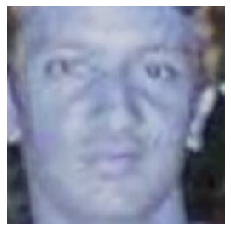

In [94]:
res = get_final_result('./checkpoint/trail_1', 7, "AtoB", 'data/model_input/trainA')

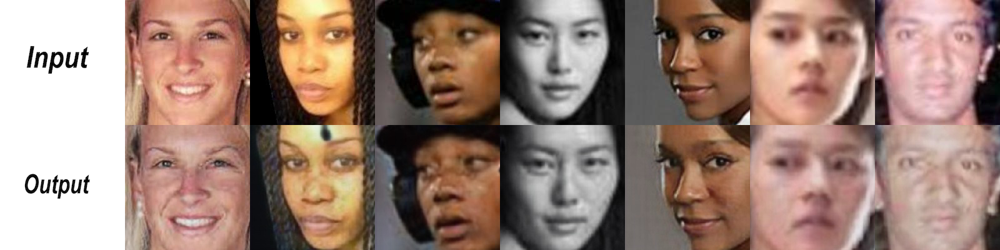

In [95]:
res

In [152]:
samples = ['data/model_input/trainA/28_1_4_20170117202546775.jpg.chip.jpg',
         'data/model_input/trainA/24_0_0_20170109214744250.jpg.chip.jpg',
         'data/model_input/trainA/23_0_4_20170117194027228.jpg.chip.jpg',
         'data/model_input/trainA/27_1_3_20170119194359132.jpg.chip.jpg',
         'data/model_input/trainA/28_1_3_20170117180649497.jpg.chip.jpg',
         'data/model_input/trainA/26_1_3_20170119193143376.jpg.chip.jpg',
         'data/model_input/trainA/28_0_0_20170117202408999.jpg.chip.jpg',
         'data/model_input/trainA/26_1_3_20170119193046825.jpg.chip.jpg',
         'data/model_input/trainA/25_0_0_20170117195255340.jpg.chip.jpg',
         'data/model_input/trainA/26_0_1_20170113181829839.jpg.chip.jpg',
           'data/model_input/trainA/21_1_3_20170104231631625.jpg.chip.jpg',
           'data/model_input/trainA/24_0_2_20170112003933482.jpg.chip.jpg',
#            'data/model_input/trainA/27_0_3_20170117175516521.jpg.chip.jpg',
#            'data/model_input/trainA/26_1_3_20170117174352558.jpg.chip.jpg',
           'data/model_input/trainA/28_1_2_20170116164556009.jpg.chip.jpg',
           'data/model_input/trainA/24_1_0_20170116215632635.jpg.chip.jpg'
        ]

test1
 [*] Reading checkpoint...
 Checkpoint name !! : 107502-107502
 Number of invoked ckpt: 107502
 check point Import succeeded
Total inputs  7
Processing image: data/model_input/trainA/28_1_4_20170117202546775.jpg.chip.jpg
saving result to  ./test_2/AtoB_28_1_4_20170117202546775.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainA/24_0_0_20170109214744250.jpg.chip.jpg
saving result to  ./test_2/AtoB_24_0_0_20170109214744250.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainA/23_0_4_20170117194027228.jpg.chip.jpg
saving result to  ./test_2/AtoB_23_0_4_20170117194027228.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainA/27_1_3_20170119194359132.jpg.chip.jpg
saving result to  ./test_2/AtoB_27_1_3_20170119194359132.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainA/28_1_3_20170117180649497.jpg.chip.jpg
saving result to  ./test_2/AtoB_28_1_3_20170117180649497.jpg.chip.jpg
log  (256, 256, 3)
Processi

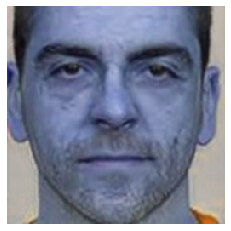

In [153]:
res = get_final_result('./checkpoint/trail_1', len(samples[:7]), "AtoB", 'data/model_input/trainA', samples = samples[:7])

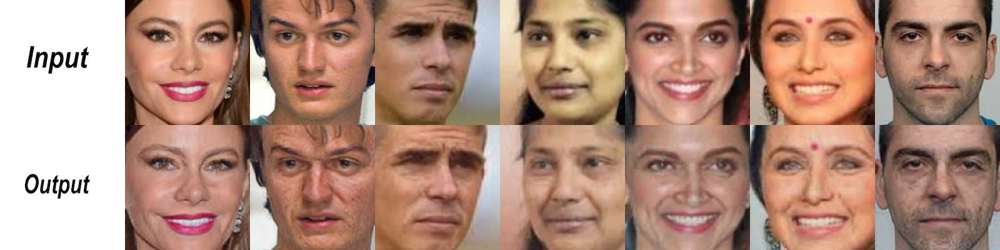

In [155]:
res

test1
 [*] Reading checkpoint...
 Checkpoint name !! : 107502-107502
 Number of invoked ckpt: 107502
 check point Import succeeded
Total inputs  7
Processing image: data/model_input/trainA/26_1_3_20170119193046825.jpg.chip.jpg
saving result to  ./test_2/AtoB_26_1_3_20170119193046825.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainA/25_0_0_20170117195255340.jpg.chip.jpg
saving result to  ./test_2/AtoB_25_0_0_20170117195255340.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainA/26_0_1_20170113181829839.jpg.chip.jpg
saving result to  ./test_2/AtoB_26_0_1_20170113181829839.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainA/21_1_3_20170104231631625.jpg.chip.jpg
saving result to  ./test_2/AtoB_21_1_3_20170104231631625.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainA/24_0_2_20170112003933482.jpg.chip.jpg
saving result to  ./test_2/AtoB_24_0_2_20170112003933482.jpg.chip.jpg
log  (256, 256, 3)
Processi

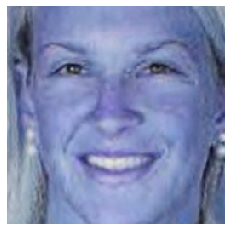

In [156]:
res = res=get_final_result('./checkpoint/trail_1', len(samples[7:14]), "AtoB", 'data/model_input/trainA', samples = samples[7:14])

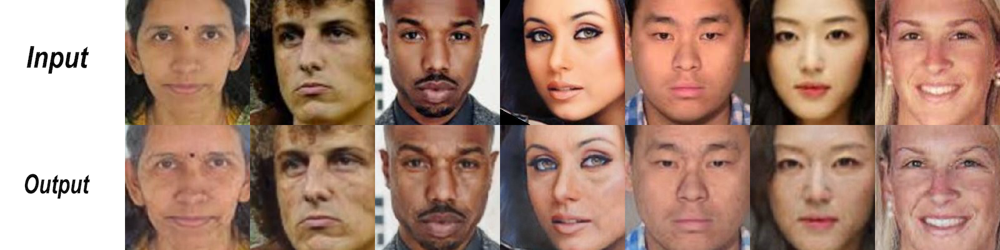

In [158]:
res

data/model_input/trainB
test1
 [*] Reading checkpoint...
 Checkpoint name !! : 107502-107502
 Number of invoked ckpt: 107502
 check point Import succeeded
Total inputs  7
Processing image: data/model_input/trainB/50_0_2_20170116175220841.jpg.chip.jpg
saving result to  ./test_2/BtoA_50_0_2_20170116175220841.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainB/53_1_1_20170116175619856.jpg.chip.jpg
saving result to  ./test_2/BtoA_53_1_1_20170116175619856.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainB/58_0_4_20170104002248350.jpg.chip.jpg
saving result to  ./test_2/BtoA_58_0_4_20170104002248350.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainB/54_0_0_20170104212507413.jpg.chip.jpg
saving result to  ./test_2/BtoA_54_0_0_20170104212507413.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainB/51_0_1_20170113173639578.jpg.chip.jpg
saving result to  ./test_2/BtoA_51_0_1_20170113173639578.jpg.chip.jpg
log

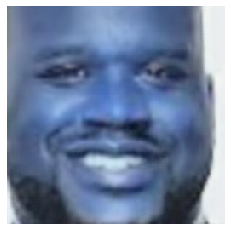

In [140]:
res = get_final_result('./checkpoint/trail_1', 7, "BtoA", 'data/model_input/trainB')

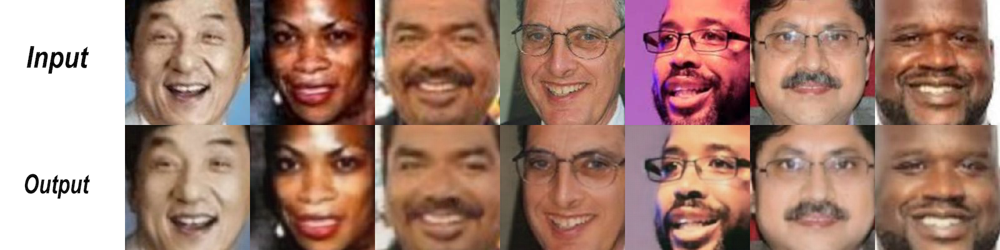

In [141]:
res

In [159]:
samples=[
    'data/model_input/trainB/51_0_0_20170120222858570.jpg.chip.jpg',
    'data/model_input/trainB/55_0_3_20170117183255158.jpg.chip.jpg',
    'data/model_input/trainB/57_0_0_20170109012626427.jpg.chip.jpg',
    'data/model_input/trainB/58_0_0_20170111205913082.jpg.chip.jpg',
    'data/model_input/trainB/53_1_0_20170110154328866.jpg.chip.jpg',
    'data/model_input/trainB/59_1_0_20170110141807087.jpg.chip.jpg',
    'data/model_input/trainB/53_1_0_20170110160643313.jpg.chip.jpg',
    'data/model_input/trainB/54_0_0_20170104212507413.jpg.chip.jpg',
    'data/model_input/trainB/51_1_3_20170109142417013.jpg.chip.jpg',
    'data/model_input/trainB/53_0_0_20170111201804638.jpg.chip.jpg',
    'data/model_input/trainB/54_1_0_20170110141340224.jpg.chip.jpg',
    'data/model_input/trainB/52_0_3_20170119205717649.jpg.chip.jpg',
    'data/model_input/trainB/55_1_0_20170110160643438.jpg.chip.jpg',
    'data/model_input/trainB/53_1_0_20170110160643329.jpg.chip.jpg'
]

test1
 [*] Reading checkpoint...
 Checkpoint name !! : 107502-107502
 Number of invoked ckpt: 107502
 check point Import succeeded
Total inputs  7
Processing image: data/model_input/trainB/51_0_0_20170120222858570.jpg.chip.jpg
saving result to  ./test_2/BtoA_51_0_0_20170120222858570.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainB/55_0_3_20170117183255158.jpg.chip.jpg
saving result to  ./test_2/BtoA_55_0_3_20170117183255158.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainB/57_0_0_20170109012626427.jpg.chip.jpg
saving result to  ./test_2/BtoA_57_0_0_20170109012626427.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainB/58_0_0_20170111205913082.jpg.chip.jpg
saving result to  ./test_2/BtoA_58_0_0_20170111205913082.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainB/53_1_0_20170110154328866.jpg.chip.jpg
saving result to  ./test_2/BtoA_53_1_0_20170110154328866.jpg.chip.jpg
log  (256, 256, 3)
Processi

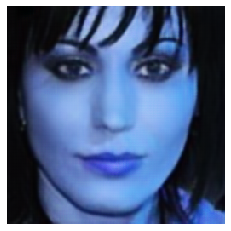

In [160]:
res = get_final_result('./checkpoint/trail_1', len(samples[:7]), "BtoA", 'data/model_input/trainB', samples = samples[:7])

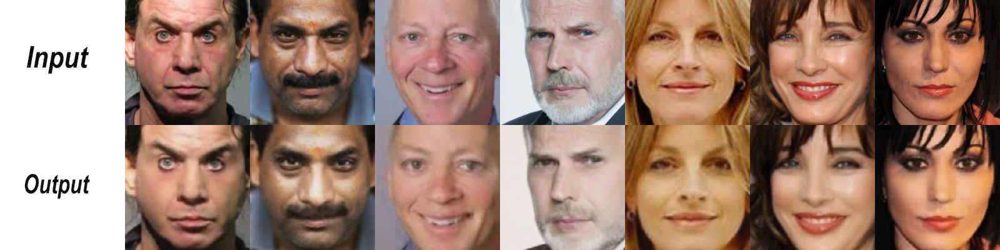

In [163]:
res.save('data/Final_outputs/50s_to_20s_1',format='png')
res

test1
 [*] Reading checkpoint...
 Checkpoint name !! : 107502-107502
 Number of invoked ckpt: 107502
 check point Import succeeded
Total inputs  7
Processing image: data/model_input/trainB/54_0_0_20170104212507413.jpg.chip.jpg
saving result to  ./test_2/BtoA_54_0_0_20170104212507413.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainB/51_1_3_20170109142417013.jpg.chip.jpg
saving result to  ./test_2/BtoA_51_1_3_20170109142417013.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainB/53_0_0_20170111201804638.jpg.chip.jpg
saving result to  ./test_2/BtoA_53_0_0_20170111201804638.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainB/54_1_0_20170110141340224.jpg.chip.jpg
saving result to  ./test_2/BtoA_54_1_0_20170110141340224.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/model_input/trainB/52_0_3_20170119205717649.jpg.chip.jpg
saving result to  ./test_2/BtoA_52_0_3_20170119205717649.jpg.chip.jpg
log  (256, 256, 3)
Processi

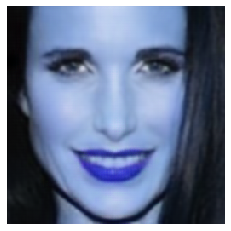

In [164]:
res = get_final_result('./checkpoint/trail_1', len(samples[7:14]), "BtoA", 'data/model_input/trainB', samples = samples[7:14])

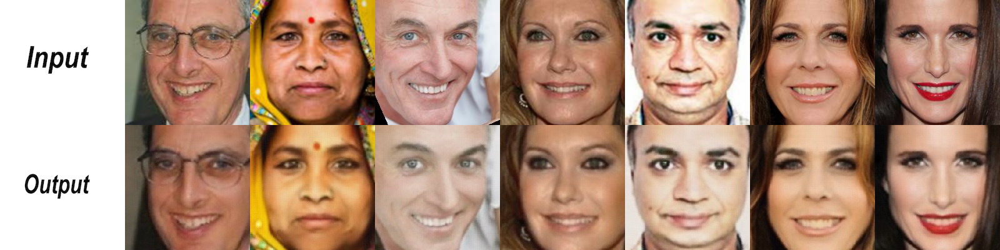

In [166]:
res.save('data/Final_outputs/50s_to_20s_2',format='png')
res

## Ethnicity

data/ethnicity_model_input/trainA
test1
 [*] Reading checkpoint...
 Checkpoint name !! : 47502-47502
 Number of invoked ckpt: 47502
 check point Import succeeded
Total inputs  12
Processing image: data/ethnicity_model_input/trainA/35_0_0_20170117170113915.jpg.chip.jpg
saving result to  ./test_2/AtoB_35_0_0_20170117170113915.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainA/80_0_0_20170117175258116.jpg.chip.jpg
saving result to  ./test_2/AtoB_80_0_0_20170117175258116.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainA/60_1_0_20170110141759687.jpg.chip.jpg
saving result to  ./test_2/AtoB_60_1_0_20170110141759687.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainA/56_1_0_20170110154644528.jpg.chip.jpg
saving result to  ./test_2/AtoB_56_1_0_20170110154644528.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainA/7_1_0_20170109202312260.jpg.chip.jpg
saving result to

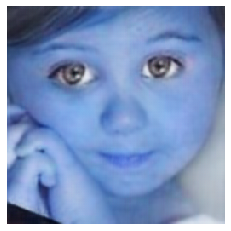

In [177]:
res = get_final_result('./checkpoint/ethnicity/trail_1', 12, "AtoB", 'data/ethnicity_model_input/trainA')

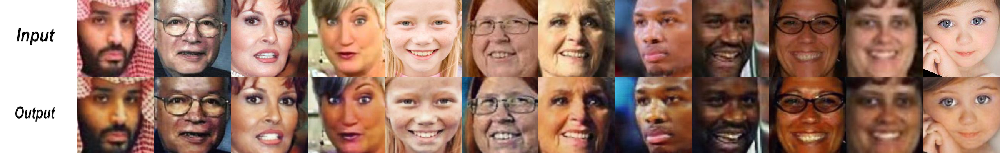

In [178]:
res

In [181]:
samples = [
    'data/ethnicity_model_input/trainA/17_1_0_20170109214546339.jpg.chip.jpg',
    'data/ethnicity_model_input/trainA/29_0_0_20170117122015236.jpg.chip.jpg',
    'data/ethnicity_model_input/trainA/11_0_0_20170110225327724.jpg.chip.jpg',
    'data/ethnicity_model_input/trainA/35_1_0_20170117134846646.jpg.chip.jpg',
    'data/ethnicity_model_input/trainA/20_1_0_20170105183447816.jpg.chip.jpg',
    'data/ethnicity_model_input/trainA/9_0_0_20170110220016235.jpg.chip.jpg',
    'data/ethnicity_model_input/trainA/56_0_0_20170109012703197.jpg.chip.jpg',
    'data/ethnicity_model_input/trainA/35_0_0_20170117180618449.jpg.chip.jpg',
    'data/ethnicity_model_input/trainA/12_1_0_20170103200659679.jpg.chip.jpg',
    'data/ethnicity_model_input/trainA/53_1_0_20170120223149451.jpg.chip.jpg',
    'data/ethnicity_model_input/trainA/20_1_0_20170112231826743.jpg.chip.jpg',
    'data/ethnicity_model_input/trainA/65_0_0_20170111210257547.jpg.chip.jpg',
    'data/ethnicity_model_input/trainA/25_1_0_20170111182452788.jpg.chip.jpg',
    'data/ethnicity_model_input/trainA/62_1_0_20170110141039449.jpg.chip.jpg'
]

test1
 [*] Reading checkpoint...
 Checkpoint name !! : 47502-47502
 Number of invoked ckpt: 47502
 check point Import succeeded
Total inputs  7
Processing image: data/ethnicity_model_input/trainA/17_1_0_20170109214546339.jpg.chip.jpg
saving result to  ./test_2/AtoB_17_1_0_20170109214546339.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainA/29_0_0_20170117122015236.jpg.chip.jpg
saving result to  ./test_2/AtoB_29_0_0_20170117122015236.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainA/11_0_0_20170110225327724.jpg.chip.jpg
saving result to  ./test_2/AtoB_11_0_0_20170110225327724.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainA/35_1_0_20170117134846646.jpg.chip.jpg
saving result to  ./test_2/AtoB_35_1_0_20170117134846646.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainA/20_1_0_20170105183447816.jpg.chip.jpg
saving result to  ./test_2/AtoB_20_1_0_20170105183

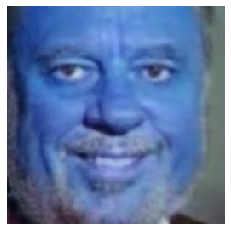

In [182]:
res = get_final_result('./checkpoint/ethnicity/trail_1', 7, "AtoB", 'data/ethnicity_model_input/trainA', samples=samples[:7])

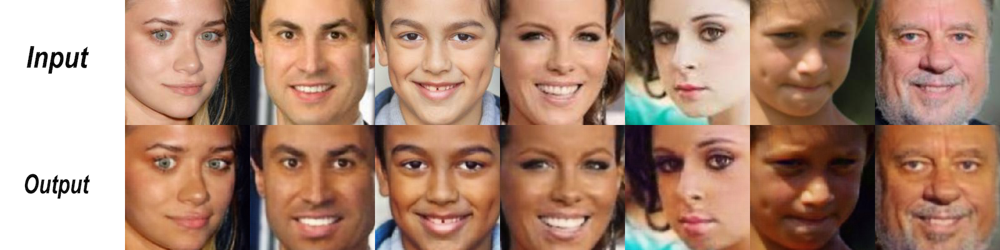

In [184]:
res.save('data/Final_outputs/white_to_black_1',format='png')
res

test1
 [*] Reading checkpoint...
 Checkpoint name !! : 47502-47502
 Number of invoked ckpt: 47502
 check point Import succeeded
Total inputs  7
Processing image: data/ethnicity_model_input/trainA/35_0_0_20170117180618449.jpg.chip.jpg
saving result to  ./test_2/AtoB_35_0_0_20170117180618449.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainA/12_1_0_20170103200659679.jpg.chip.jpg
saving result to  ./test_2/AtoB_12_1_0_20170103200659679.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainA/53_1_0_20170120223149451.jpg.chip.jpg
saving result to  ./test_2/AtoB_53_1_0_20170120223149451.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainA/20_1_0_20170112231826743.jpg.chip.jpg
saving result to  ./test_2/AtoB_20_1_0_20170112231826743.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainA/65_0_0_20170111210257547.jpg.chip.jpg
saving result to  ./test_2/AtoB_65_0_0_20170111210

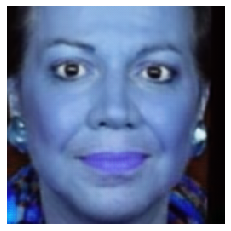

In [185]:
res = get_final_result('./checkpoint/ethnicity/trail_1', 7, "AtoB", 'data/ethnicity_model_input/trainA', samples=samples[7:14])

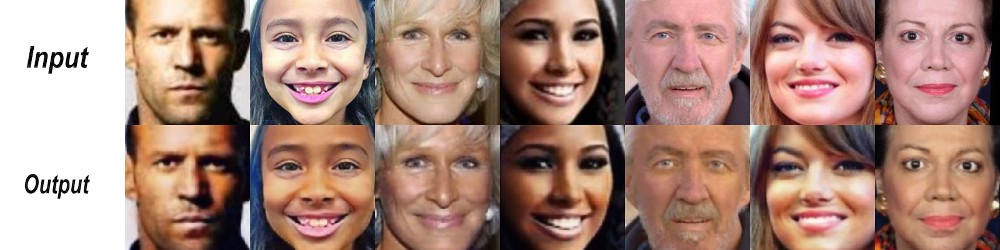

In [187]:
res.save('data/Final_outputs/white_to_black_2',format='png')
res

data/ethnicity_model_input/trainB
test1
 [*] Reading checkpoint...
 Checkpoint name !! : 47502-47502
 Number of invoked ckpt: 47502
 check point Import succeeded
Total inputs  12
Processing image: data/ethnicity_model_input/trainB/26_0_1_20170113134332736.jpg.chip.jpg
saving result to  ./test_2/BtoA_26_0_1_20170113134332736.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainB/56_0_1_20170120222838627.jpg.chip.jpg
saving result to  ./test_2/BtoA_56_0_1_20170120222838627.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainB/35_0_1_20170117104607288.jpg.chip.jpg
saving result to  ./test_2/BtoA_35_0_1_20170117104607288.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainB/29_1_1_20170116231405050.jpg.chip.jpg
saving result to  ./test_2/BtoA_29_1_1_20170116231405050.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainB/50_1_1_20170114030118769.jpg.chip.jpg
saving result t

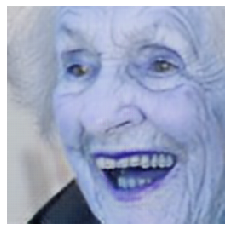

In [196]:
res = get_final_result('./checkpoint/ethnicity/trail_1', 12, "BtoA", 'data/ethnicity_model_input/trainB')

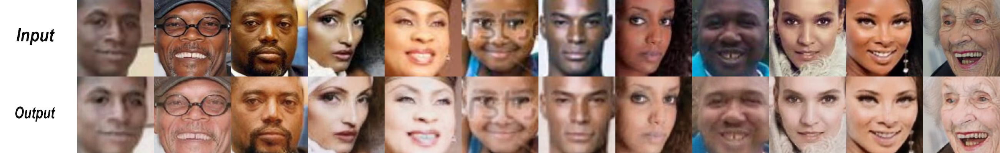

In [197]:
res

In [205]:
samples=[
    'data/ethnicity_model_input/trainB/46_0_1_20170113141909603.jpg.chip.jpg',
    'data/ethnicity_model_input/trainB/55_0_1_20170117165048545.jpg.chip.jpg',
    'data/ethnicity_model_input/trainB/21_1_1_20170112193015117.jpg.chip.jpg',
    'data/ethnicity_model_input/trainB/14_0_1_20170117133924867.jpg.chip.jpg',
    'data/ethnicity_model_input/trainB/26_0_1_20170116142947678.jpg.chip.jpg',
    'data/ethnicity_model_input/trainB/28_1_1_20170112220128599.jpg.chip.jpg',
    'data/ethnicity_model_input/trainB/26_1_1_20170116183008326.jpg.chip.jpg',
    'data/ethnicity_model_input/trainB/26_1_1_20170112230617333.jpg.chip.jpg',
    'data/ethnicity_model_input/trainB/31_0_1_20170116024828447.jpg.chip.jpg',
    'data/ethnicity_model_input/trainB/18_1_1_20170116211857195.jpg.chip.jpg',
    'data/ethnicity_model_input/trainB/32_1_1_20170113012946729.jpg.chip.jpg',
    'data/ethnicity_model_input/trainB/14_1_1_20170112230439326.jpg.chip.jpg',
    'data/ethnicity_model_input/trainB/16_1_1_20170112191148791.jpg.chip.jpg',
    'data/ethnicity_model_input/trainB/96_1_1_20170110183853718.jpg.chip.jpg'
]

test1
 [*] Reading checkpoint...
 Checkpoint name !! : 47502-47502
 Number of invoked ckpt: 47502
 check point Import succeeded
Total inputs  7
Processing image: data/ethnicity_model_input/trainB/46_0_1_20170113141909603.jpg.chip.jpg
saving result to  ./test_2/BtoA_46_0_1_20170113141909603.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainB/55_0_1_20170117165048545.jpg.chip.jpg
saving result to  ./test_2/BtoA_55_0_1_20170117165048545.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainB/21_1_1_20170112193015117.jpg.chip.jpg
saving result to  ./test_2/BtoA_21_1_1_20170112193015117.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainB/14_0_1_20170117133924867.jpg.chip.jpg
saving result to  ./test_2/BtoA_14_0_1_20170117133924867.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainB/26_0_1_20170116142947678.jpg.chip.jpg
saving result to  ./test_2/BtoA_26_0_1_20170116142

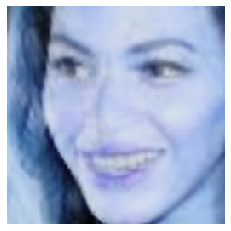

In [206]:
res = get_final_result('./checkpoint/ethnicity/trail_1', 7, "BtoA", 'data/ethnicity_model_input/trainB', samples=samples[:7])

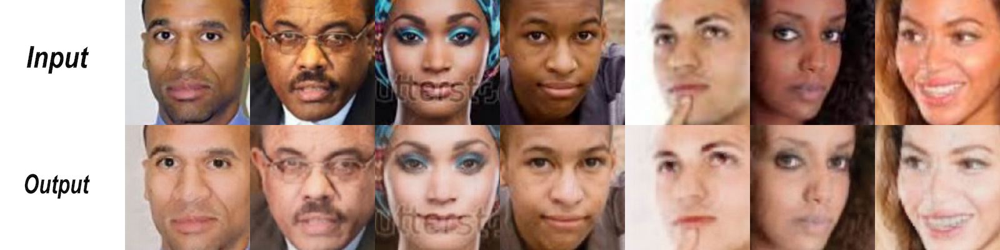

In [208]:
res.save('data/Final_outputs/black_to_white_1',format='png')
res

test1
 [*] Reading checkpoint...
 Checkpoint name !! : 47502-47502
 Number of invoked ckpt: 47502
 check point Import succeeded
Total inputs  7
Processing image: data/ethnicity_model_input/trainB/26_1_1_20170112230617333.jpg.chip.jpg
saving result to  ./test_2/BtoA_26_1_1_20170112230617333.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainB/31_0_1_20170116024828447.jpg.chip.jpg
saving result to  ./test_2/BtoA_31_0_1_20170116024828447.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainB/18_1_1_20170116211857195.jpg.chip.jpg
saving result to  ./test_2/BtoA_18_1_1_20170116211857195.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainB/32_1_1_20170113012946729.jpg.chip.jpg
saving result to  ./test_2/BtoA_32_1_1_20170113012946729.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/ethnicity_model_input/trainB/14_1_1_20170112230439326.jpg.chip.jpg
saving result to  ./test_2/BtoA_14_1_1_20170112230

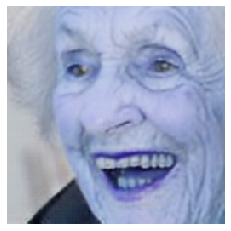

In [209]:
res = get_final_result('./checkpoint/ethnicity/trail_1', 7, "BtoA", 'data/ethnicity_model_input/trainB', samples=samples[7:14])

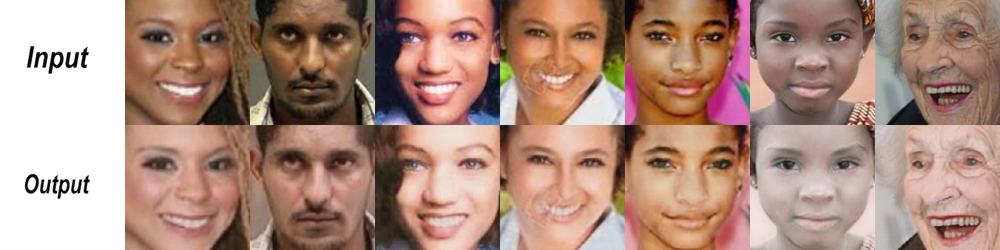

In [211]:
res.save('data/Final_outputs/black_to_white_2',format='png')
res

## Gender

data/gender_model_input/trainA
test1
 [*] Reading checkpoint...
 Checkpoint name !! : 132002-132002
 Number of invoked ckpt: 132002
 check point Import succeeded
Total inputs  12
Processing image: data/gender_model_input/trainA/53_0_0_20170117163657978.jpg.chip.jpg
saving result to  ./test_2/AtoB_53_0_0_20170117163657978.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainA/26_0_3_20170119181013021.jpg.chip.jpg
saving result to  ./test_2/AtoB_26_0_3_20170119181013021.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainA/26_0_1_20170113135547147.jpg.chip.jpg
saving result to  ./test_2/AtoB_26_0_1_20170113135547147.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainA/28_0_0_20170117180611163.jpg.chip.jpg
saving result to  ./test_2/AtoB_28_0_0_20170117180611163.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainA/29_0_0_20170104235501676.jpg.chip.jpg
saving result to  ./test_2/Ato

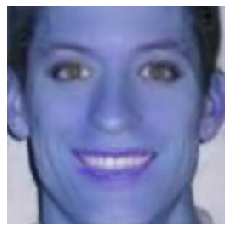

In [235]:
res = get_final_result('./checkpoint/gender/trail_1', 12, "AtoB", 'data/gender_model_input/trainA')

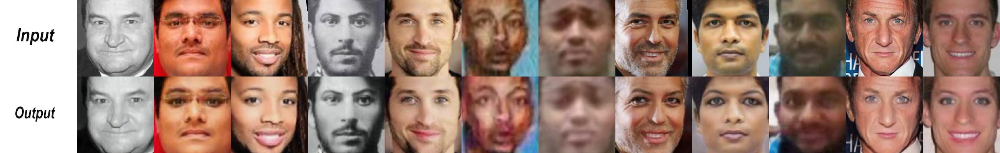

In [236]:
res

In [308]:
samples=[
    'data/gender_model_input/trainA/28_0_2_20170116190154379.jpg.chip.jpg',
    'data/gender_model_input/trainA/25_0_2_20170117195218570.jpg.chip.jpg',
    'data/gender_model_input/trainA/26_0_1_20170113134255295.jpg.chip.jpg',
    'data/gender_model_input/trainA/26_0_3_20170117153142796.jpg.chip.jpg',
    'data/gender_model_input/trainA/53_0_0_20170111202035978.jpg.chip.jpg',
    'data/gender_model_input/trainA/22_0_3_20170119150454309.jpg.chip.jpg',
    'data/gender_model_input/trainA/28_0_3_20170119194510275.jpg.chip.jpg',
    'data/gender_model_input/trainA/25_0_1_20170113132617968.jpg.chip.jpg',
    'data/gender_model_input/trainA/24_0_0_20170116222408305.jpg.chip.jpg',
    'data/gender_model_input/trainA/56_0_0_20170109012217972.jpg.chip.jpg',
    'data/gender_model_input/trainA/59_0_0_20170109011033488.jpg.chip.jpg',
    'data/gender_model_input/trainA/29_0_4_20170103235201420.jpg.chip.jpg',
    'data/gender_model_input/trainA/26_0_3_20170119150512262.jpg.chip.jpg',
    'data/gender_model_input/trainA/53_0_0_20170111171747425.jpg.chip.jpg'
    
]

test1
 [*] Reading checkpoint...
 Checkpoint name !! : 132002-132002
 Number of invoked ckpt: 132002
 check point Import succeeded
Total inputs  7
Processing image: data/gender_model_input/trainA/28_0_2_20170116190154379.jpg.chip.jpg
saving result to  ./test_2/AtoB_28_0_2_20170116190154379.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainA/25_0_2_20170117195218570.jpg.chip.jpg
saving result to  ./test_2/AtoB_25_0_2_20170117195218570.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainA/26_0_1_20170113134255295.jpg.chip.jpg
saving result to  ./test_2/AtoB_26_0_1_20170113134255295.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainA/26_0_3_20170117153142796.jpg.chip.jpg
saving result to  ./test_2/AtoB_26_0_3_20170117153142796.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainA/53_0_0_20170111202035978.jpg.chip.jpg
saving result to  ./test_2/AtoB_53_0_0_20170111202035978.jpg.c

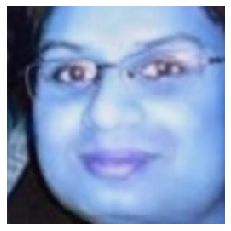

In [309]:
res = get_final_result('./checkpoint/gender/trail_1', 7, "AtoB", 'data/gender_model_input/trainA', samples=samples[:7])

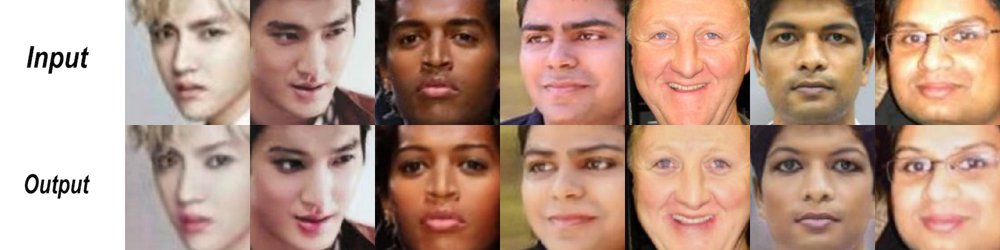

In [311]:
res.save('data/Final_outputs/male_to_female_1',format='png')
res

test1
 [*] Reading checkpoint...
 Checkpoint name !! : 132002-132002
 Number of invoked ckpt: 132002
 check point Import succeeded
Total inputs  7
Processing image: data/gender_model_input/trainA/25_0_1_20170113132617968.jpg.chip.jpg
saving result to  ./test_2/AtoB_25_0_1_20170113132617968.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainA/24_0_0_20170116222408305.jpg.chip.jpg
saving result to  ./test_2/AtoB_24_0_0_20170116222408305.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainA/56_0_0_20170109012217972.jpg.chip.jpg
saving result to  ./test_2/AtoB_56_0_0_20170109012217972.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainA/59_0_0_20170109011033488.jpg.chip.jpg
saving result to  ./test_2/AtoB_59_0_0_20170109011033488.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainA/29_0_4_20170103235201420.jpg.chip.jpg
saving result to  ./test_2/AtoB_29_0_4_20170103235201420.jpg.c

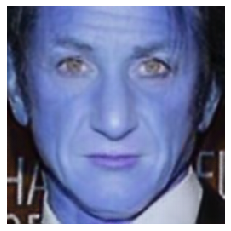

In [306]:
res = get_final_result('./checkpoint/gender/trail_1', 7, "AtoB", 'data/gender_model_input/trainA', samples=samples[7:14])

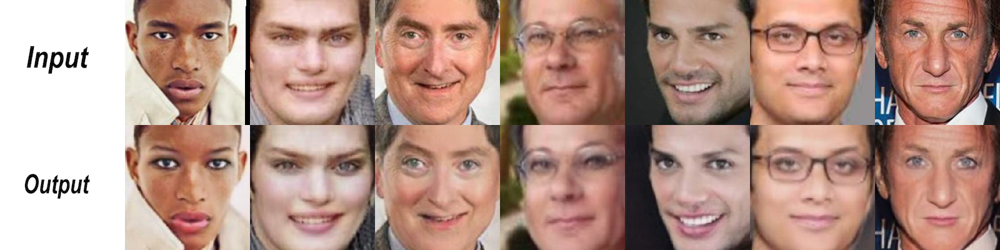

In [307]:
# res.save('data/Final_outputs/male_to_female_2',format='png')
res

data/gender_model_input/trainB
test1
 [*] Reading checkpoint...
 Checkpoint name !! : 132002-132002
 Number of invoked ckpt: 132002
 check point Import succeeded
Total inputs  12
Processing image: data/gender_model_input/trainB/22_1_1_20170112231734479.jpg.chip.jpg
saving result to  ./test_2/BtoA_22_1_1_20170112231734479.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainB/27_1_3_20170119194422834.jpg.chip.jpg
saving result to  ./test_2/BtoA_27_1_3_20170119194422834.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainB/50_1_0_20170110151434231.jpg.chip.jpg
saving result to  ./test_2/BtoA_50_1_0_20170110151434231.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainB/26_1_2_20170116183745463.jpg.chip.jpg
saving result to  ./test_2/BtoA_26_1_2_20170116183745463.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainB/23_1_2_20170116173039449.jpg.chip.jpg
saving result to  ./test_2/Bto

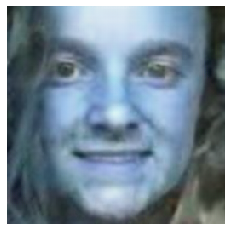

In [253]:
res = get_final_result('./checkpoint/gender/trail_1', 12, "BtoA", 'data/gender_model_input/trainB')

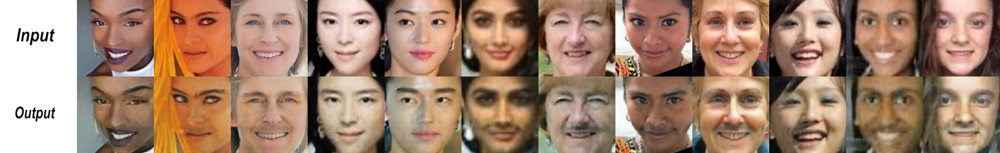

In [254]:
res

In [298]:
samples = [
    'data/gender_model_input/trainB/21_1_1_20170113005835590.jpg.chip.jpg',
    'data/gender_model_input/trainB/25_1_0_20170103182309849.jpg.chip.jpg',
    'data/gender_model_input/trainB/27_1_2_20161219192627707.jpg.chip.jpg',
    'data/gender_model_input/trainB/23_1_2_20170104020318141.jpg.chip.jpg',
        'data/gender_model_input/trainB/28_1_2_20170116165514344.jpg.chip.jpg',
    'data/gender_model_input/trainB/28_1_2_20170104022917342.jpg.chip.jpg',
    'data/gender_model_input/trainB/26_1_1_20170103181931657.jpg.chip.jpg',
    'data/gender_model_input/trainB/29_1_0_20170103163136424.jpg.chip.jpg',
    'data/gender_model_input/trainB/23_1_2_20170116173152188.jpg.chip.jpg',
    'data/gender_model_input/trainB/26_1_2_20170104022654101.jpg.chip.jpg',
    'data/gender_model_input/trainB/27_1_1_20170112234058559.jpg.chip.jpg',
    'data/gender_model_input/trainB/22_1_2_20170114033415747.jpg.chip.jpg',
    'data/gender_model_input/trainB/24_1_4_20170117194848067.jpg.chip.jpg',
    'data/gender_model_input/trainB/50_1_0_20170110151434231.jpg.chip.jpg'
]

test1
 [*] Reading checkpoint...
 Checkpoint name !! : 132002-132002
 Number of invoked ckpt: 132002
 check point Import succeeded
Total inputs  7
Processing image: data/gender_model_input/trainB/21_1_1_20170113005835590.jpg.chip.jpg
saving result to  ./test_2/BtoA_21_1_1_20170113005835590.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainB/25_1_0_20170103182309849.jpg.chip.jpg
saving result to  ./test_2/BtoA_25_1_0_20170103182309849.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainB/27_1_2_20161219192627707.jpg.chip.jpg
saving result to  ./test_2/BtoA_27_1_2_20161219192627707.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainB/23_1_2_20170104020318141.jpg.chip.jpg
saving result to  ./test_2/BtoA_23_1_2_20170104020318141.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainB/28_1_2_20170116165514344.jpg.chip.jpg
saving result to  ./test_2/BtoA_28_1_2_20170116165514344.jpg.c

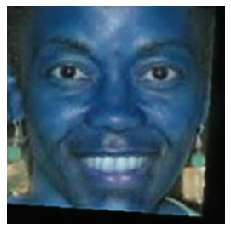

In [299]:
res = get_final_result('./checkpoint/gender/trail_1', 7, "BtoA", 'data/gender_model_input/trainB', samples=samples[:7])

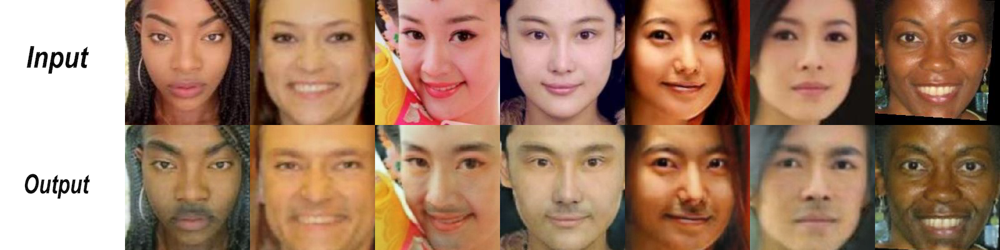

In [301]:
res.save('data/Final_outputs/female_to_male_1.png',format='png')
res

test1
 [*] Reading checkpoint...
 Checkpoint name !! : 132002-132002
 Number of invoked ckpt: 132002
 check point Import succeeded
Total inputs  7
Processing image: data/gender_model_input/trainB/29_1_0_20170103163136424.jpg.chip.jpg
saving result to  ./test_2/BtoA_29_1_0_20170103163136424.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainB/23_1_2_20170116173152188.jpg.chip.jpg
saving result to  ./test_2/BtoA_23_1_2_20170116173152188.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainB/26_1_2_20170104022654101.jpg.chip.jpg
saving result to  ./test_2/BtoA_26_1_2_20170104022654101.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainB/27_1_1_20170112234058559.jpg.chip.jpg
saving result to  ./test_2/BtoA_27_1_1_20170112234058559.jpg.chip.jpg
log  (256, 256, 3)
Processing image: data/gender_model_input/trainB/22_1_2_20170114033415747.jpg.chip.jpg
saving result to  ./test_2/BtoA_22_1_2_20170114033415747.jpg.c

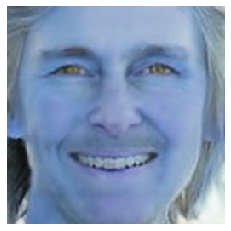

In [302]:
res = get_final_result('./checkpoint/gender/trail_1', len(samples[7:]), "BtoA", 'data/gender_model_input/trainB', samples=samples[7:])

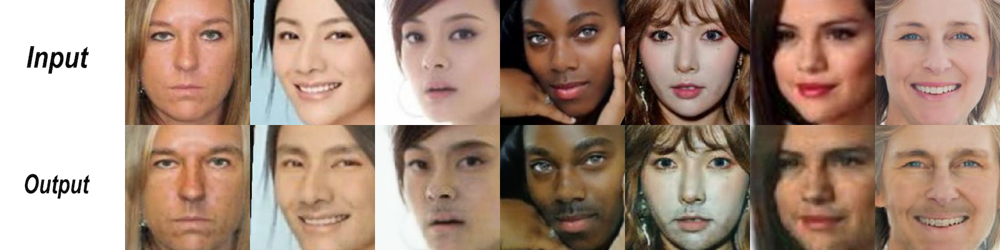

In [304]:
res.save('data/Final_outputs/female_to_male_2.png',format='png')
res